# Dealing with large Cabled Array datasets


In [1]:
import numpy as np
import pandas as pd
import xarray as xr

In [2]:
url_uncabled = 'https://opendap.oceanobservatories.org/thredds/dodsC/ooi/michaesm-marine-rutgers/20170725T195526-CE06ISSM-RID16-03-CTDBPC000-telemetered-ctdbp_cdef_dcl_instrument/deployment0006_CE06ISSM-RID16-03-CTDBPC000-telemetered-ctdbp_cdef_dcl_instrument.ncml'

We are going to use xarray to open the dataset. Once the dataset is open, we are going to convert part of our dataset referred to as a DataArray into a Pandas Dataframe for ease of use.

In [3]:
ds = xr.open_dataset(url_uncabled, decode_times=True)
ds.data_vars

Data variables:
    deployment                      (obs) int32 ...
    id                              (obs) |S64 ...
    conductivity                    (obs) float64 ...
    date_time_string                (obs) object ...
    dcl_controller_timestamp        (obs) object ...
    driver_timestamp                (obs) datetime64[ns] ...
    ingestion_timestamp             (obs) datetime64[ns] ...
    internal_timestamp              (obs) datetime64[ns] ...
    port_timestamp                  (obs) datetime64[ns] ...
    preferred_timestamp             (obs) object ...
    pressure                        (obs) float64 ...
    provenance                      (obs) |S64 ...
    quality_flag                    (obs) |S64 ...
    temp                            (obs) float64 ...
    practical_salinity              (obs) float64 ...
    density                         (obs) float64 ...
    conductivity_qc_executed        (obs) float64 ...
    conductivity_qc_results         (obs) float64 ..

In [4]:
# Lets select these two variables to plot
x = 'time'
y = 'pressure'

In [5]:
df1 = ds[y].to_dataframe()
ds.close()

In [6]:
# Import Bokeh functions
import os
from bokeh.plotting import figure, output_file, reset_output, show, ColumnDataSource, save
from bokeh.models import BoxAnnotation
from bokeh.io import output_notebook # required to display Bokeh visualization in notebook

In [9]:
source = ColumnDataSource(
    data=dict(
        x=df1[x],
        y=df1[y],
    )
)

p = figure(width=600,
           height=400,
           title='CE06ISSM-RID16-03-CTDBPC000',
           x_axis_label='Time (GMT)',
           y_axis_label='Pressure (m)',
           x_axis_type='datetime')

p.line('x', 'y', line_width=3, source=source)
p.circle('x', 'y', fill_color='white', size=4, source=source)
output_notebook()
show(p)

'/Users/knuth/Documents/ooi/repos/github/cahw2018_tutorials/ooi_m2m_demo/ooi_m2m_3_large_format_data_vis/plot.html'

## Drawbacks of normal plotting backends (Matplotlib, Bokeh, etc.)

While Bokeh is a nice tool for interactive data visualization, it does not work very well with large datasets that number greater than tens of thousands of points. Most python plotting toolboxes have a limit to the amount of data they can plot, so the best approach to plotting these datasets in those toolboxes would be to downsample. However, downsampling is destructive and may cause us to miss out on important peaks or troughs in data. Since the Cabled Array data can have millions of points over a very small period of time, it's important to look at toolboxes that allow for non-destructive data visualization. 

Previously, we loaded a smaller CTD dataset from the Washington Inshore Surface Mooring (CE06ISSM). Now we are going to load a much larger dataset from the ASHES Vent Field. We will use xarray to utilize the lazy loading capability of dask and then plot the data with datashader.

In [8]:
url_cabled = 'https://opendap.oceanobservatories.org/thredds/dodsC/ooi/friedrich-knuth-rutgers/20180219T191719-RS03ASHS-MJ03B-10-CTDPFB304-streamed-ctdpf_optode_sample/deployment0003_RS03ASHS-MJ03B-10-CTDPFB304-streamed-ctdpf_optode_sample_20180205T190209.102547-20180219T190208.809978.nc'
ds = xr.open_dataset(url_cabled, decode_times=False)

Datashader does not handle datetimes very well so we loaded the netCDF file with xarray with the decode_times argument set equal to False. 

In [9]:
cdf = ds[y].to_dataframe()

# Datashader

With datashader, you can easily plot every data point for a given time series. Datashader utilizes the processing power of your computer in order to dynamically update the data as you zoom and pan. This allows for non-destructive data exploration 

This notebook makes use of this dynamic update capability but requires running a live Jupyter. If these plots are viewed statically by a Jupyter notebook viewer (such as on github) or are downloaded and not run on the server, the plots will not update when you zoom and pan. 

In [10]:
import datashader as dsp
import datashader.transfer_functions as tf

cvs = dsp.Canvas(plot_width=600, plot_height=400)
agg = cvs.line(cdf, x, y)

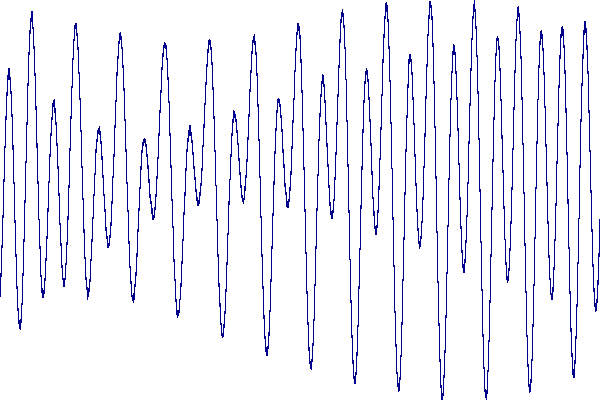

In [11]:
img = tf.shade(agg)
img

As you can see in the plot above, the results look the same as what you would get from any plotting program. However, you cannot easily resolve the peaks and troughs of the data just by looking.

Next, let's use every 1000 points instead of plotting everything.

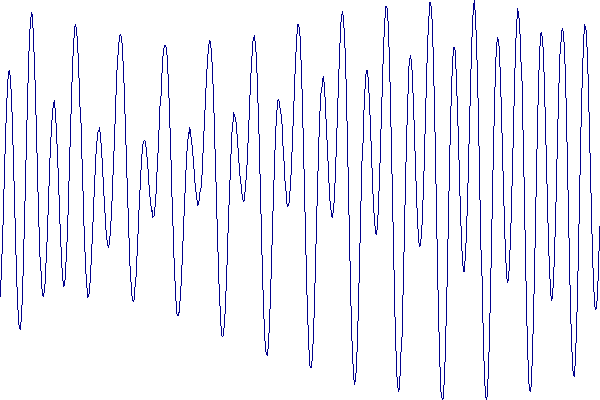

In [12]:
sampling = 1000
tf.shade(cvs.line(cdf[::sampling], 'time', 'pressure'))

This plot is similar to the one above, but you can see that points were removed compared to the previous graph. These points may have important information that we want to don't want to lose.

## Holoviews
The easiest way to use Datashader is via the HoloViews package. Holoviews allows you to easily generate both Datashader and non-Datashader plots with Matplotlib, Bokeh, or Plotly. 


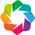

In [13]:
import holoviews as hv
from holoviews.operation.datashader import aggregate, datashade, dynspread, shade
from holoviews.operation import decimate
hv.notebook_extension('bokeh')

Unlike datashader, HoloViews handles datetimes well. We will go ahead and convert the time integer from the ds into a datetime and save it as new variable

In [14]:
ds = xr.decode_cf(ds)
cdf2 = ds[y].to_dataframe()

/Users/mikesmith/miniconda2/envs/sprk_waves/lib/python2.7/site-packages/xarray/conventions.py:1037: UserWarning: CF decoding is overwriting dtype on variable u'id'
  .format(name))
/Users/mikesmith/miniconda2/envs/sprk_waves/lib/python2.7/site-packages/xarray/conventions.py:1037: UserWarning: CF decoding is overwriting dtype on variable u'conductivity'
  .format(name))
/Users/mikesmith/miniconda2/envs/sprk_waves/lib/python2.7/site-packages/xarray/conventions.py:1037: UserWarning: CF decoding is overwriting dtype on variable u'oxy_calphase'
  .format(name))
/Users/mikesmith/miniconda2/envs/sprk_waves/lib/python2.7/site-packages/xarray/conventions.py:1037: UserWarning: CF decoding is overwriting dtype on variable u'oxy_temp'
  .format(name))
/Users/mikesmith/miniconda2/envs/sprk_waves/lib/python2.7/site-packages/xarray/conventions.py:1037: UserWarning: CF decoding is overwriting dtype on variable u'oxygen'
  .format(name))
/Users/mikesmith/miniconda2/envs/sprk_waves/lib/python2.7/site-pa

In [15]:
from bokeh.models import DatetimeTickFormatter
def apply_formatter(plot, element):
    plot.handles['xaxis'].formatter = DatetimeTickFormatter()

In [16]:
%%opts RGB [width=600]

curve = hv.Curve((cdf2[x], cdf2[y]))
curve

:Curve   [x]   (y)

In [17]:
%%opts RGB [finalize_hooks=[apply_formatter] width=800]


datashade(curve, cmap=["blue"])

:DynamicMap   []

HoloViews also supplies some operations that are useful in combination with Datashader timeseries. For instance, you can compute a rolling mean of the results and then show a subset of outlier points, which will then support hover, selection, and other interactive Bokeh features:

In [18]:
%%opts Overlay [finalize_hooks=[apply_formatter] width=800] 
%%opts Scatter [tools=['hover', 'box_select']] (line_color="black" fill_color="red" size=10)
from holoviews.operation.timeseries import rolling, rolling_outlier_std
smoothed = rolling(curve, rolling_window=50)
outliers = rolling_outlier_std(curve, rolling_window=50, sigma=2)

datashade(curve, cmap=["blue"]) * dynspread(datashade(smoothed, cmap=["red"]),max_px=1) * outliers

:DynamicMap   []